# Liquid Neural Networks: A Novel Approach to Dynamic Neural Computation
By Sydney Bach (design/architecture) Claude.ai for his math genius and coding and beautiful math markup.

The concept is to cache blocks of inference into cubes as transformers find their path through the network.

These cubes of data will do transfer learning over time from the transformer and predict the outputs based on past activations. In this hybrid architecture, the LNN gradually influences the outputs of the transformer based, leveraging its strengths with attention and having neuroplastic properties, can adapt over time and make new predictions.

## Future plans

The original design was to have the cube of inference to have the liquid neurons take over inference for that block and switch off the gate and become a fully mentored LNN matrix. 

Cubes would also solve the limitations of the LNNs requiring the whole block of neurons being computed together. By breaking up the inference into chunks and having parallel processing of the chunks, you essentially have a distributed LNN which may be able to take advantage of multiprocessing and threading.

This Python implementation is more or less a proof leading to the Kotlin port which will use Kotlin's actor and channel system to allow LangChain-like interface design with "virtual dendrites" and virtual cortical connections for blocks.

The blocks would then have hybridized LNN/Transformer feed forwards to other blocks and so on, similar to the layering built up in the human brain and leveraging a sort of phonological loop of reflection which strengthens the learning. This part of the design is still pure theory.

## Introduction

This paper explores the integration of Transformer and Liquid Neural Network (LNN) architectures, building upon foundational work by Hasani et al. (2020). The key innovation lies in combining the parallel processing capabilities of Transformers with the adaptive dynamics of LNNs.
## Mathematical Framework

### 1. Core LNN Dynamics

Building on recent advances in closed-form continuous-time neural networks (Hasani et al., 2022), we start with the fundamental LNN equation:

$
\frac{dx(t)}{dt} = -\left[\frac{1}{\tau} + f(x(t), I(t), t, \theta)\right] x(t) + f(x(t), I(t), t, \theta) A
$

Which has the approximate closed-form solution:

$
x(t) = \sigma\left(-f(x, I; \theta_f) t\right) \odot g(x, I; \theta_g) + \left[1 - \sigma\left(-f(x, I; \theta_f) t\right)\right] \odot h(x, I; \theta_h)
$


This formulation provides several key advantages:
1. Eliminates the need for ODE solvers while maintaining continuous-time properties.
2. Enables explicit time-dependent gating mechanisms.
3. Allows direct optimization of temporal dynamics.

Where:
- $x(t)$ is the hidden state.
- $\tau$ is the time constant.
- $f$ is a neural network parameterized by $\theta$
- $I(t)$ represents input.
- $A$ is a bias vector.

### 2. Bounded Dynamics Proof

Key theorem from Hasani et al. (2020):

$
\frac{\tau_i}{1 + \tau_i W_i} \leq \tau_{\text{sys}_i} \leq \tau_i
$

This guarantees stable system dynamics even with unbounded inputs.

## Proposed Architecture Enhancement

### Integration with Transformer Blocks

Our approach combines the strengths of Transformers' parallel processing with LNNs' continuous-time adaptability. Following Hasani et al. (2022), we implement this through:

1. Continuous-Time Gating:

$
x(t) = \sigma(-f(x, I; \theta_f) t) \odot g(x, I; \theta_g) + \left[1 - \sigma(-f(x, I; \theta_f) t)\right] \odot h(x, I; \theta_h)
$

2. Memory Cubes Architecture:

$
C = \{P, F, O\}
$

Where:
- $P$: perceptron layer
- $F$: feed-forward network
- $O$: output transformation

Cube-to-Cube Communication:

$
C_{ij} = f(W_i C_i + W_j C_j)
$

### Dynamic Time Constants

Building on Hasani's work, we introduce variable time constants:

$
\tau_{\text{sys}} = \frac{\tau}{1 + \tau f(x(t), I(t), t, \theta)}
$

This allows for adaptive computation based on input complexity.

## Experimental Validation

Our implementation builds on proven performance metrics from Hasani et al.:

1. Time Series Prediction:
   - Gesture Recognition: `69.55% ± 1.13` accuracy
   - Room Occupancy: `94.63% ± 0.17` accuracy
   - Traffic Estimation: `0.099 ± 0.0095` squared error

2. Computational Efficiency:

$
\text{fused\_solver\_step}(x, I, \Delta t, \theta) = \frac{x + \Delta t f(x, I, t, \theta) A}{1 + \Delta t \left(\frac{1}{\tau} + f(x, I, t, \theta)\right)}
$

## Theoretical Foundations

Building on established theory from Hasani et al., we prove:

**Theorem 1**: The combined Transformer-LNN system maintains bounded stability under the conditions:
1. $∀i: τ_i > 0$
2. $∥W_i∥ ≤ K$ for some constant $K$
3. $f$ is Lipschitz continuous

**Proof sketch**:

Given the Lyapunov function $V(x) = ∥x∥²$, we show:

$
\frac{dV}{dt} \leq 0
$

under the above conditions.

## Appendix: Implementation Guidelines

### Stability Constraints

For system stability, maintain:

$
1. 0 < τ_{min} ≤ τ_i ≤ τ_{max}
$
$
2. ∥W_i∥ ≤ \sqrt{\frac{2}{n}}  \quad \text{where } n \text{ is the input dimension}
$
$
3. ∥A∥ ≤ A_{max}
$


## Implementation
I am primarily using a Transformer architecture combined with a novel liquid neural network approach. Specifically, we are
using several key transformer components:

*1. Multi-Head Attention* - visible in our code through:

```
self.attention = nn.MultiheadAttention(hidden_size, num_heads, dropout=dropout)
```

*2. Scaled Dot-Product Attention* - which is the underlying mechanism in the attention layer

The innovative aspect is that I'm combining these Transformer components with Liquid Neural Networks (from Hasani et al.'s work), which isn't on the list but represents a novel architecture that uses continuous-time neural dynamics.

Key components from our implementation:

```
class TransformerLNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_heads=4):
        # Transformer components
        self.attention = nn.MultiheadAttention(...)
        
        # LNN components
        self.ltc = LiquidTimeConstant(...)
```

This is a hybrid architecture that combines:

* Traditional Transformer attention mechanisms
* Continuous-time neural dynamics from LNNs
* Time-dependent gating mechanisms

So while "Transformer" is the base architecture, I'm extending it significantly with the liquid neural network approach for handling temporal dynamics.

I'll break down each section of my experiment and explain what it's doing and how:

Data Generation & Processing

## Generate synthetic data with multiple patterns

```
def generate_synthetic_data(num_samples=1000, seq_length=50, input_dim=10):
    # Create time steps
    t = torch.linspace(0, 10, seq_length)
    
    # Generate diverse patterns (sine waves with different frequencies)
    patterns = []
    for i in range(input_dim):
        freq1, freq2 = (i + 1) * 0.5, (i + 1) * 0.25
        pattern = torch.sin(2 * np.pi * freq1 * t) + \
                 0.5 * torch.sin(2 * np.pi * freq2 * t)
        patterns.append(pattern)
```
*What*: Creates synthetic sequential data with multiple overlapping patterns
*How*: Combines sine waves of different frequencies to create complex temporal patterns
*Why*: Provides controlled data to test the model's ability to learn temporal dependencies

## Model Architecture

pythonCopyclass TransformerLNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_heads):
        # Transformer component for parallel processing
        self.attention = nn.MultiheadAttention(...)
        
        # LNN component for temporal dynamics
        self.ltc = LiquidTimeConstant(...)
*What:* Hybrid architecture combining Transformer attention with liquid neural networks
*How:*
* Uses attention to process sequences in parallel
* Uses LNN for continuous-time modeling of temporal dependencies
* Combines both through a shared backbone network

## Training Loop

```
for epoch in range(NUM_EPOCHS):
    for batch_idx, (x, y) in enumerate(train_loader):
        # Forward pass
        y_pred = model(x)
        loss = criterion(y_pred, y)
        
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # Visualization updates
        if batch_idx % visualizer.save_intervals == 0:
            update_visualizations()
```

*What:* Trains the model while tracking multiple metrics
*How:*
* Processes batches of sequences
* Updates model parameters using gradient descent
* Collects performance metrics and model states
* Updates visualizations in real-time

# The key innovation here is how it combines:


* Transformer's parallel processing (attention)
* LTC's continuous time dynamics (liquid state)
* Time-dependent gating to balance both

# Overview: Transformer-LNN hybrid approach
[![](https://mermaid.ink/img/pako:eNqNlftu2jAUxl_FcqWJdqEihNsidRKBtnSjgEomoZEqMolDMoKdJY6AXv7dA-wR9ySzHS4Ja7tGCMXh-53z-eT48Agd6mKoQy-kK8dHMQNm1yKAX0k6m8co8sENiVJmYpLQOJlaUC7Bdm3B-0wtrgn_dQ2mM8QcXwEJ_mmHmCggEICdBA_4viA3uZwFS5wcIwcZJq5FjuyMYvoDOyygZG_m8KjoB5TLn8HobviFK_sBwSguHcyAP79-Az9wXUzk-rTACkriPc76_24qB75tt80YJsKaEVJnwYPtHwjbDk6SgMwLqXsyr3nXHoxVUaIYkSSiCS5VFLVoMtNkNtumqKdvI8bAdG9zaztzWyy_ICSakbdpyIIeRu7eX0G9E8uU1YItVam8YKsq5YPh3a3YRB9tcDyg8fLNWvXNzq5K_Pa1-siYMjoX9YfDEZdf0Rhg5PhANhTDEWB6AdpKJdYZDjptsWcHsdJ0bTNeIJvdK8ANlhfloxpnYskZBmcM5CxmlGAwwGxF40VBbBhSOB71b0T8cRQGDDAKNBAh5hdPixRJ-ZMFTW5bRLTgE7gSqGczcAGSYL6kgVsSu7IJZqevRxgzxDC4FgGuxUGc22sRQDwVpD3_H9oTaG8im6iI-gX0ygQfQMZet81LkUrgB7Nl4f0MHJkVWg5eT_hXLzuZRv9y0JX5CF7xADLOGRDOP4KSWhbrU_6A-3mzbYYp44d61znZ6rXmkTmzl2S2O1-5nu_TWZSopJKsB45aQCr37Vx9sZ13jZm1_fCbWRw7uXEh585hDBVTbcFdEB5g876BmquLE6Ik6WIPMDmjOzTkh8MLwlA_8T55SsJiusD6iaZp2_vyKnCZr1ej9VEAGuXh2ew9cC4EmCg9RYwZhW8l7yavEdtVhMYwFNEjSvaGtqmhApc4XqLA5f9Rj4Ljk8fHS2xBnd-62EN8blnQIs9cilJGxxviQJ3FKVZgTNO5D3UPhQlfpZHLG6obIN41y50kQuQ7pfkl1B_hGurVWuu83qy11GarUVO1WqWuwA3UG83zVqXRatbFp6Wpzwp8kLx63myq9YZa1Spaq66pjee_xR073w?type=png)](https://mermaid.live/edit#pako:eNqNlftu2jAUxl_FcqWJdqEihNsidRKBtnSjgEomoZEqMolDMoKdJY6AXv7dA-wR9ySzHS4Ja7tGCMXh-53z-eT48Agd6mKoQy-kK8dHMQNm1yKAX0k6m8co8sENiVJmYpLQOJlaUC7Bdm3B-0wtrgn_dQ2mM8QcXwEJ_mmHmCggEICdBA_4viA3uZwFS5wcIwcZJq5FjuyMYvoDOyygZG_m8KjoB5TLn8HobviFK_sBwSguHcyAP79-Az9wXUzk-rTACkriPc76_24qB75tt80YJsKaEVJnwYPtHwjbDk6SgMwLqXsyr3nXHoxVUaIYkSSiCS5VFLVoMtNkNtumqKdvI8bAdG9zaztzWyy_ICSakbdpyIIeRu7eX0G9E8uU1YItVam8YKsq5YPh3a3YRB9tcDyg8fLNWvXNzq5K_Pa1-siYMjoX9YfDEZdf0Rhg5PhANhTDEWB6AdpKJdYZDjptsWcHsdJ0bTNeIJvdK8ANlhfloxpnYskZBmcM5CxmlGAwwGxF40VBbBhSOB71b0T8cRQGDDAKNBAh5hdPixRJ-ZMFTW5bRLTgE7gSqGczcAGSYL6kgVsSu7IJZqevRxgzxDC4FgGuxUGc22sRQDwVpD3_H9oTaG8im6iI-gX0ygQfQMZet81LkUrgB7Nl4f0MHJkVWg5eT_hXLzuZRv9y0JX5CF7xADLOGRDOP4KSWhbrU_6A-3mzbYYp44d61znZ6rXmkTmzl2S2O1-5nu_TWZSopJKsB45aQCr37Vx9sZ13jZm1_fCbWRw7uXEh585hDBVTbcFdEB5g876BmquLE6Ik6WIPMDmjOzTkh8MLwlA_8T55SsJiusD6iaZp2_vyKnCZr1ej9VEAGuXh2ew9cC4EmCg9RYwZhW8l7yavEdtVhMYwFNEjSvaGtqmhApc4XqLA5f9Rj4Ljk8fHS2xBnd-62EN8blnQIs9cilJGxxviQJ3FKVZgTNO5D3UPhQlfpZHLG6obIN41y50kQuQ7pfkl1B_hGurVWuu83qy11GarUVO1WqWuwA3UG83zVqXRatbFp6Wpzwp8kLx63myq9YZa1Spaq66pjee_xR073w)


## LiquidTimeConstant (LTC) Class


### Core components
- Backbone network: Takes combined input+hidden state, processes through 2 linear layers with tanh
- Three specialized networks:
  * time_net: Controls temporal dynamics
  * state_net_g: Transforms state for short-term memory
  * state_net_h: Transforms state for long-term memory
- Learnable parameters:
  * tau: Time constants (initialized to ones)
  * A: Bias terms (initialized randomly)

### Forward pass:
1. Combines input and hidden state
2. Processes through backbone network
3. Computes time-constant factor using sigmoid
4. Applies state transformations
5. Uses time-dependent gating to blend states

# LTC diagram with explanations
[![](https://mermaid.ink/img/pako:eNqNV21P4zgQ_itWTiskRLlCeWmj00rAHuzqYA8dlU667apyk2lj1bGD7VC6lP9-45e8tKW78KFK4pnx88w8MzYvUSJTiOJopmiRkeHlSIwEwb8PH8gXUZSG3CuZgNZMzPyCLife1i2Pm-Vvo2jLI_runZyjWXLY8iJTxnnM2SwzE17CgTZKziH-rdfrhefOgqUmi4-K5wqb_WMujobHetsHeCxBJPDHRP3-cX__34waMpOg0TTe33dfO2TIciAaFMPvKTU0fPa-hlFOcqC6VJDjq65XhZaKKKApItZhg4eMFoCRybcJNUl2gGEfxxzEAZkCNRhCf1_j3zwZBDFmYioRuwP0BZ9VTg2Too2eGZJIYSgTep2BNjQvdJsSEwbUE-U1ZDTgNr2KGvgV4gYniLQlgKGiQltkoMg9NdmGAFrLY7ts2Wx4xPYXkQnyDyRyJpil-IYqNkO1VFEwMX-3KvKMIoq7khvW-YzlIhe4u3gjrykKo8npNROpxvpyVwKdscKqxqanUVSHuLAFot2D5wKU0XuESzknGLElpT9pkpHM7q0LSFBR7IfTICl8Jnwx3M8tmwPJ6JOtU14Fp4LypQ7as_HtKm6xlKVy-xDNrDEVIEvNlzs0JjCZR5iLW7rEWny18kIkbYndl6qQGposPBg6YR4uB6oEbhxW_gLAjKC8Sk8lySCZh7XPwHHNKFSpRbqQak4mYKluEJ1jEMeFv9FkUhCTYWdS254J5bBDkrfDq7ekiJ8rCVYWsWuMzsWCKvj5SKqcW6KbKcBGfq_qJjSZT6QA3P0yPJKvYGwqfiq7K4nQwrAg8Iw5TOr6dMitrQGmOy-kwmqbdQF1mp7Rfhg2ImxyjmLJqTKWGbpiihGGq60PssD3vfYWWNtaZzuENUMNuWHfSu-N-7ZLV1c4w5TkFmY95siUy0VYv6ScYpdpJKgN6j8lBQ5PlEZYv0hpYVBi0g1OLw-9gyhq9Ak8z7mQi4omCOteaiApm05BgeNao9lBNYdcqiVS_bQUNGcJuXMfAs_rMOUbonfYA25ao7Bw7BL5ZHOOmLeI-IIlGRUzqOp5iZMYp1AD0Hq-STaMDErSgCtvcDnqZZHasU8WDFUtYOG47uiov0tjsdyAAOWTsd5afn3crGM-tn22u2rLr9VeS-BY_nf3VyLzCXPtFXKOkrJf1qaZ7_BWMUDNnKZc03QmVENan8y1Ml3gkCib7w51grb52lRnUxhqJ7vZrMpEYVFsXYycAQ4zhVG0ZesNp0rmrRjhCNmhPOmSZwkjSx5y2Z4l2KUEd2noBv7IcePUGjassK1S5kZMlYD7teys4f3lLcdjHGs8MHZdILDzBfgN_bf61kY6nY-ra7xUhfqEY4_plT3DdxkbsJMKE1LU83xVT1_vVN-tnNNNyVIsXe2X4omsLZxVmGPeCbd05vUJWAtl5Q9Sb1bt5PEEC4JTJARbD-qfnW2YgGEshO5chbb11m4bZ1zdmBoIQf8Bq3NylsOK1g7T8OIz4ftwTQSrUMORiA4ivHrllKX4r8CL9R5FKOEcj-EYH1OYUrxyjKKReEVTWhr5sBRJFBuFV_ZIyXKWRfEUr5_45ul9YhTnR15_Laj4T8q8csHXKH6JnqP4uHd8eNwbDHqD825_cHYyOIiWUTzoHp6fdbtH5-dHJyenJ_3j14Poh_M_OhycDs77Z8eD0_6g2-_2X_8HbONX3w?type=png)](https://mermaid.live/edit#pako:eNqNV21P4zgQ_itWTiskRLlCeWmj00rAHuzqYA8dlU667apyk2lj1bGD7VC6lP9-45e8tKW78KFK4pnx88w8MzYvUSJTiOJopmiRkeHlSIwEwb8PH8gXUZSG3CuZgNZMzPyCLife1i2Pm-Vvo2jLI_runZyjWXLY8iJTxnnM2SwzE17CgTZKziH-rdfrhefOgqUmi4-K5wqb_WMujobHetsHeCxBJPDHRP3-cX__34waMpOg0TTe33dfO2TIciAaFMPvKTU0fPa-hlFOcqC6VJDjq65XhZaKKKApItZhg4eMFoCRybcJNUl2gGEfxxzEAZkCNRhCf1_j3zwZBDFmYioRuwP0BZ9VTg2Too2eGZJIYSgTep2BNjQvdJsSEwbUE-U1ZDTgNr2KGvgV4gYniLQlgKGiQltkoMg9NdmGAFrLY7ts2Wx4xPYXkQnyDyRyJpil-IYqNkO1VFEwMX-3KvKMIoq7khvW-YzlIhe4u3gjrykKo8npNROpxvpyVwKdscKqxqanUVSHuLAFot2D5wKU0XuESzknGLElpT9pkpHM7q0LSFBR7IfTICl8Jnwx3M8tmwPJ6JOtU14Fp4LypQ7as_HtKm6xlKVy-xDNrDEVIEvNlzs0JjCZR5iLW7rEWny18kIkbYndl6qQGposPBg6YR4uB6oEbhxW_gLAjKC8Sk8lySCZh7XPwHHNKFSpRbqQak4mYKluEJ1jEMeFv9FkUhCTYWdS254J5bBDkrfDq7ekiJ8rCVYWsWuMzsWCKvj5SKqcW6KbKcBGfq_qJjSZT6QA3P0yPJKvYGwqfiq7K4nQwrAg8Iw5TOr6dMitrQGmOy-kwmqbdQF1mp7Rfhg2ImxyjmLJqTKWGbpiihGGq60PssD3vfYWWNtaZzuENUMNuWHfSu-N-7ZLV1c4w5TkFmY95siUy0VYv6ScYpdpJKgN6j8lBQ5PlEZYv0hpYVBi0g1OLw-9gyhq9Ak8z7mQi4omCOteaiApm05BgeNao9lBNYdcqiVS_bQUNGcJuXMfAs_rMOUbonfYA25ao7Bw7BL5ZHOOmLeI-IIlGRUzqOp5iZMYp1AD0Hq-STaMDErSgCtvcDnqZZHasU8WDFUtYOG47uiov0tjsdyAAOWTsd5afn3crGM-tn22u2rLr9VeS-BY_nf3VyLzCXPtFXKOkrJf1qaZ7_BWMUDNnKZc03QmVENan8y1Ml3gkCib7w51grb52lRnUxhqJ7vZrMpEYVFsXYycAQ4zhVG0ZesNp0rmrRjhCNmhPOmSZwkjSx5y2Z4l2KUEd2noBv7IcePUGjassK1S5kZMlYD7teys4f3lLcdjHGs8MHZdILDzBfgN_bf61kY6nY-ra7xUhfqEY4_plT3DdxkbsJMKE1LU83xVT1_vVN-tnNNNyVIsXe2X4omsLZxVmGPeCbd05vUJWAtl5Q9Sb1bt5PEEC4JTJARbD-qfnW2YgGEshO5chbb11m4bZ1zdmBoIQf8Bq3NylsOK1g7T8OIz4ftwTQSrUMORiA4ivHrllKX4r8CL9R5FKOEcj-EYH1OYUrxyjKKReEVTWhr5sBRJFBuFV_ZIyXKWRfEUr5_45ul9YhTnR15_Laj4T8q8csHXKH6JnqP4uHd8eNwbDHqD825_cHYyOIiWUTzoHp6fdbtH5-dHJyenJ_3j14Poh_M_OhycDs77Z8eD0_6g2-_2X_8HbONX3w)


In [1]:
import torch
import torch.nn as nn
import numpy as np
from typing import Optional, Tuple

class LiquidTimeConstant(nn.Module):
    """
    Implements time-aware processing with dynamic memory
    Like a smart system that knows how to balance past and present information
    """
    def __init__(self, input_size: int, hidden_size: int):
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        
        # BACKBONE NETWORK
        # Core feature extraction - like a smart filter
        self.backbone = nn.Sequential(
            nn.Linear(input_size + hidden_size, hidden_size),
            nn.Tanh(),  # Smooth activation for stability
            nn.Linear(hidden_size, hidden_size)
        )
        
        # TEMPORAL PROCESSING NETWORKS
        # Time-aware processing mechanisms
        
        # Controls how time influences processing
        self.time_net = nn.Linear(hidden_size, hidden_size)
        
        # Transform state for short-term memory
        self.state_net_g = nn.Linear(hidden_size, hidden_size)
        
        # Transform state for long-term memory
        self.state_net_h = nn.Linear(hidden_size, hidden_size)
        
        # LEARNABLE PARAMETERS
        # Time constants - control information flow speed
        self.tau = nn.Parameter(torch.ones(hidden_size))
        # Bias terms - help network learn better
        self.A = nn.Parameter(torch.randn(hidden_size))

    def forward(self, 
                x: torch.Tensor,  # Current input
                h: torch.Tensor,  # Memory state
                t: torch.Tensor   # Time information
               ) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        Updates memory state based on new information and time
        Like dynamically updating notes as you get new information
        """
        # Combine current input with memory
        combined = torch.cat([x, h], dim=-1)
        # Extract features
        features = self.backbone(combined)
        
        # TEMPORAL GATING
        # Compute how much time should influence the update
        f_t = torch.sigmoid(self.time_net(features))
        
        # STATE TRANSFORMATIONS
        # Process for different timescales
        g_x = self.state_net_g(features)  # Short-term
        h_x = self.state_net_h(features)  # Long-term
        
        # TIME-DEPENDENT GATING
        # Decide how to blend different timescales
        gate = torch.sigmoid(-f_t * t.view(-1, 1))
        
        # MEMORY UPDATE
        # Blend short and long-term information
        h_new = gate * g_x + (1 - gate) * h_x
        
        return h_new, h_new

## TransformerLNN Class

### Core components
- input_proj: Projects input to higher dimension
- attention: Multi-head attention for parallel processing
- ltc: Liquid time-constant layer
- output_proj: Projects back to input dimension
- Two layer normalizations for stability

### Forward pass:
1. Projects input to higher dimension
2. Applies self-attention and normalizes
3. Processes sequence through LTC:
   - Maintains a running state
   - Updates state for each time step
   - Collects outputs
4. Combines and normalizes outputs
5. Projects back to original dimension

# Tensor operations with explanations
[![](https://mermaid.ink/img/pako:eNqNVm1v2zYQ_iuEim5rYGf1W5IKQ4GmSdoCyRYsAQasLgJaPFmsKVIlqdlunP--44tsxXFe9Iki73jH53nuyNskUwySNJlqWhXk-ngsx5Lg9_o1-SKr2pITammYMvUkWPmFG7fwdZy0rJJvwdAb26WAliXJuRCp4NPCTkQNHWO1mkH6ajAYxHF3zpkt0l61aHJwH_c7LNaBruBHDTKDPyb69_d7e1cFrSDd2yNfJ9RmRYcY-HEjQHaio-E_4Vu0PV3QshLe-pqXgKaagyFsO_Xt4BaDe4cvMle6pJYr-Uz4R0Iai79mHQwkuwc3t5wKcqlVBsZwOX0Auze42Rh4VB547aJh27NFx1TD8sV0VFp933CB4JIP7HttbAnS-jN3yQWtTECOWEUKzhhIwvD00jTAdck5nwHRgPS4ZKgkvKRTeISGsAeGjfkDC8J6VgPBsSWCLvmbZwVoDF1hdEzas0lUHjJ-hJprTaVx3KPnJbXFFjGt5Ru37PSy5ZGSc6BaGvdjAQc7WNrepsXREoRQ8xez5GJIdzDM5KIWlnc_A2XkQzMdgfunoJZwS5gCg_hFhM64ZEhgWSltqbQIlfAgmYJXpk1fQf9z5JUuAIqcwKICbQ0RSs0wBV9Y0f6UZgUpXA65ymqDVaecJvIcNGZEqm1Q7sN_fv1xF-w43cDdWKTkM5VM4P6u3HZg3Pjc1z9q5aXQTmg2mygJGPQ4DsmfYOdKzyKql7WulIENoKcLq2mGwMxgSXKgtkbptYGkhAFURDiFxNpEOBqLoJsNH9UuBW1GU2ohNqzuMXW18gnpk9MnOf-oJJ5ZuLpdtziSo-Ti-glknCGqc_T-tZ2MXJvEk5iSahtPgGC5-LiV3WajBShWKsOEzwIw5Nj9b_KNJd9OtZxwibmYAnMgv6Dc5LSL0UpSQqn0smlDfOGa-1pj1rf8jIo19sdUULxJUIuCYQtiRMK8DcAjasT6wH77V21dv7ivSL90E5bckdqWD7XYtg56fJW_y1-sRLUrTEStAWkDm9cDnVNEuJEg-Q2r4U1cj32pGyjbmLSa0pvtfntFEVJqnmydqCwJme8fYS5e6KTbfb86A4wVrgrXLFb-eglmbuRtogCwcehG-giWl8hq0-iecPLEF64teJemgNvZWO_k7_h2AUxrL3qG4ndXl1n54gqOzTbxHBEu9Bb-eeIsfbjnPFyGJV-E1ITHrqlib7iuzGDkjuhOds_YD8O2Xgp4tTEeMF9FmQTDNVwBpJ2UbzySToKsl5QzfB_euh3GiS3AVXKKQwY5xdY_TsbyDk1pbdXVUmZJajW-7xKt6mmRpDkVBv_qCgmGE06xUMr1bEXlv0qVjQv-JultskjS7sH-6PBo0Bv1-4PRQa-PpZAscXpwsP-uf9Tr9UbD0VG_1xse3HWSn36L_n6_d_h2OByMBsOjUe_t4bCTIAxW6YvwwvUP3bv_Ae79qTM?type=png)](https://mermaid.live/edit#pako:eNqNVm1v2zYQ_iuEim5rYGf1W5IKQ4GmSdoCyRYsAQasLgJaPFmsKVIlqdlunP--44tsxXFe9Iki73jH53nuyNskUwySNJlqWhXk-ngsx5Lg9_o1-SKr2pITammYMvUkWPmFG7fwdZy0rJJvwdAb26WAliXJuRCp4NPCTkQNHWO1mkH6ajAYxHF3zpkt0l61aHJwH_c7LNaBruBHDTKDPyb69_d7e1cFrSDd2yNfJ9RmRYcY-HEjQHaio-E_4Vu0PV3QshLe-pqXgKaagyFsO_Xt4BaDe4cvMle6pJYr-Uz4R0Iai79mHQwkuwc3t5wKcqlVBsZwOX0Auze42Rh4VB547aJh27NFx1TD8sV0VFp933CB4JIP7HttbAnS-jN3yQWtTECOWEUKzhhIwvD00jTAdck5nwHRgPS4ZKgkvKRTeISGsAeGjfkDC8J6VgPBsSWCLvmbZwVoDF1hdEzas0lUHjJ-hJprTaVx3KPnJbXFFjGt5Ru37PSy5ZGSc6BaGvdjAQc7WNrepsXREoRQ8xez5GJIdzDM5KIWlnc_A2XkQzMdgfunoJZwS5gCg_hFhM64ZEhgWSltqbQIlfAgmYJXpk1fQf9z5JUuAIqcwKICbQ0RSs0wBV9Y0f6UZgUpXA65ymqDVaecJvIcNGZEqm1Q7sN_fv1xF-w43cDdWKTkM5VM4P6u3HZg3Pjc1z9q5aXQTmg2mygJGPQ4DsmfYOdKzyKql7WulIENoKcLq2mGwMxgSXKgtkbptYGkhAFURDiFxNpEOBqLoJsNH9UuBW1GU2ohNqzuMXW18gnpk9MnOf-oJJ5ZuLpdtziSo-Ti-glknCGqc_T-tZ2MXJvEk5iSahtPgGC5-LiV3WajBShWKsOEzwIw5Nj9b_KNJd9OtZxwibmYAnMgv6Dc5LSL0UpSQqn0smlDfOGa-1pj1rf8jIo19sdUULxJUIuCYQtiRMK8DcAjasT6wH77V21dv7ivSL90E5bckdqWD7XYtg56fJW_y1-sRLUrTEStAWkDm9cDnVNEuJEg-Q2r4U1cj32pGyjbmLSa0pvtfntFEVJqnmydqCwJme8fYS5e6KTbfb86A4wVrgrXLFb-eglmbuRtogCwcehG-giWl8hq0-iecPLEF64teJemgNvZWO_k7_h2AUxrL3qG4ndXl1n54gqOzTbxHBEu9Bb-eeIsfbjnPFyGJV-E1ITHrqlib7iuzGDkjuhOds_YD8O2Xgp4tTEeMF9FmQTDNVwBpJ2UbzySToKsl5QzfB_euh3GiS3AVXKKQwY5xdY_TsbyDk1pbdXVUmZJajW-7xKt6mmRpDkVBv_qCgmGE06xUMr1bEXlv0qVjQv-JultskjS7sH-6PBo0Bv1-4PRQa-PpZAscXpwsP-uf9Tr9UbD0VG_1xse3HWSn36L_n6_d_h2OByMBsOjUe_t4bCTIAxW6YvwwvUP3bv_Ae79qTM)

In [2]:
class TransformerLNN(nn.Module):
    """
    Hybrid architecture combining Transformer attention (for pattern recognition)
    with LTC dynamics (for temporal processing)
    """
    def __init__(self, 
                 input_size: int,  # Size of each input feature
                 hidden_size: int, # Size of internal representations
                 num_heads: int = 4,  # Number of attention "experts"
                 dropout: float = 0.1):
        super().__init__()
        
        self.hidden_size = hidden_size
        self.num_heads = num_heads
        
        # INPUT PROCESSING
        # Projects input to higher dimension for richer representation
        # Like resizing data to give the network more room to work
        self.input_proj = nn.Linear(input_size, hidden_size)
        
        # TRANSFORMER PATH: Pattern Recognition
        # Multi-head attention: Multiple "experts" look at data simultaneously
        # Each head can specialize in finding different types of patterns
        self.attention = nn.MultiheadAttention(hidden_size, num_heads, dropout=dropout)
        
        # LTC PATH: Time-Aware Processing
        # Processes temporal aspects and maintains dynamic memory
        self.ltc = LiquidTimeConstant(hidden_size, hidden_size)
        
        # OUTPUT PROCESSING
        # Projects back to original dimension for predictions
        self.output_proj = nn.Linear(hidden_size, input_size)
        
        # STABILIZATION
        # Keep values in check during processing (like keeping measurements on same scale)
        self.norm1 = nn.LayerNorm(hidden_size)
        self.norm2 = nn.LayerNorm(hidden_size)

    def forward(self, 
                x: torch.Tensor,  # Input shape: [batch, seq_len, input_size]
                times: Optional[torch.Tensor] = None,  # Time info: [batch, seq_len]
                mask: Optional[torch.Tensor] = None) -> torch.Tensor:
        """
        Forward pass combining parallel pattern recognition (Transformer)
        with sequential time-aware processing (LTC)
        """
        batch_size, seq_len, _ = x.shape
        
        # Generate time information if none provided
        # Like adding timestamps if they're missing
        if times is None:
            times = torch.arange(seq_len, dtype=torch.float32, device=x.device)
            times = times.unsqueeze(0).expand(batch_size, -1)
        
        # PROJECT INPUT
        # Transform to richer representation
        h = self.input_proj(x)
        
        # TRANSFORMER PATH: Find Patterns
        # Rearrange for attention ([seq_len, batch, hidden])
        h_att = h.transpose(0, 1)
        # Let multiple experts look at sequence relationships
        h_att, _ = self.attention(h_att, h_att, h_att, attn_mask=mask)
        # Rearrange back ([batch, seq, hidden])
        h_att = h_att.transpose(0, 1)
        # Stabilize with residual connection and normalization
        h_att = self.norm1(h + h_att)
        
        # LTC PATH: Process Time Information
        # Initialize memory state
        ltc_state = torch.zeros(batch_size, self.hidden_size, device=x.device)
        outputs = []
        
        # Process sequence step by step, maintaining memory
        for t in range(seq_len):
            ltc_in = h_att[:, t]  # Current timestep
            # Update memory and get output
            ltc_out, ltc_state = self.ltc(ltc_in, ltc_state, times[:, t])
            outputs.append(ltc_out)
        
        # COMBINE FEATURES
        # Stack timestep outputs
        outputs = torch.stack(outputs, dim=1)
        # Merge time-aware features with pattern features
        outputs = self.norm2(outputs + h_att)
        
        # GENERATE PREDICTIONS
        # Project back to input size
        y = self.output_proj(outputs)
        
        return y  # Shape: [batch, seq_len, input_size]
    def get_attention_weights(self, x: torch.Tensor) -> torch.Tensor:
        """Helper method to extract attention weights for visualization"""
        h = self.input_proj(x)
        h = h.transpose(0, 1)
        _, attn_weights = self.attention(h, h, h, need_weights=True)
        return attn_weights

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import clear_output
import seaborn as sns
from typing import List, Dict, Optional
from datetime import datetime

class TrainingVisualizer:

    def __init__(self, save_intervals: int = 10, plot_intervals: int = 5):
        self.save_intervals = save_intervals
        self.plot_intervals = plot_intervals

        # History tracking
        self.losses: List[float] = []
        self.accuracies: List[float] = []
        self.ltc_states: List[torch.Tensor] = []
        self.attn_weights: List[torch.Tensor] = []
        self.timestamps: List[str] = []

    def update_metrics(self, loss: float, accuracy: float, 
                      ltc_state: torch.Tensor, attn_weights: torch.Tensor):

        """Update training metrics"""

        self.losses.append(loss)
        self.accuracies.append(accuracy)
        self.ltc_states.append(ltc_state.detach().cpu())
        self.attn_weights.append(attn_weights.detach().cpu())
        self.timestamps.append(datetime.now().strftime("%H:%M:%S"))

    def plot_training_progress(self, epoch: int, batch_idx: int, x: torch.Tensor, y: torch.Tensor, y_pred: torch.Tensor):
        """Plot comprehensive training visualizations"""
        # Convert tensors to 2D by taking first channel/feature
        x_plot = x[:, :, 0].cpu().detach().numpy()  # Take first feature dimension
        y_plot = y[:, :, 0].cpu().detach().numpy()
        y_pred_plot = y_pred[:, :, 0].cpu().detach().numpy()
     
        clear_output(wait=True)
        plt.figure(figsize=(20, 12))
      
        # Plot actual visualizations using 2D data
        plt.subplot(231)
        plt.plot(self.losses[-100:], label='Training Loss', color='blue')
        plt.title(f'Loss Curve (Current: {self.losses[-1]:.4f})')
        plt.xlabel('Last 100 Steps')
        plt.ylabel('Loss')
        plt.grid(True)

        # Use the 2D versions for prediction plots
        plt.subplot(235)
        idx = 0  # Plot first sequence in batch
        plt.plot(y_plot[idx], label='Ground Truth', color='blue', alpha=0.7)
        plt.plot(y_pred_plot[idx], label='Prediction', color='red', alpha=0.7)
        plt.title('Prediction vs Ground Truth')
        plt.xlabel('Sequence Step')
        plt.ylabel('Value')
        plt.legend()
        plt.grid(True)

    def generate_synthetic_data(num_samples: int = 1000,
                            seq_length: int = 50,
                            input_dim: int = 10,
                            device: str = 'cuda' if torch.cuda.is_available() else 'cpu'
                            ) -> tuple[torch.Tensor, torch.Tensor]:

        """Generate synthetic sequence data with multiple patterns"""

        # Time steps

        t = torch.linspace(0, 10, seq_length, device=device)
        t = t.view(1, -1, 1).repeat(num_samples, 1, input_dim)     

        # Generate diverse patterns

        patterns = []

        for i in range(input_dim):
 
            # Combine sine waves with different frequencies

            freq1 = (i + 1) * 0.5
            freq2 = (i + 1) * 0.25

            pattern = torch.sin(2 * np.pi * freq1 * t[..., i]) + \
                    0.5 * torch.sin(2 * np.pi * freq2 * t[..., i])

            patterns.append(pattern)      

        # Combine patterns

        x = torch.stack(patterns, dim=-1)

        # Create target with transformations

        y = torch.roll(x, shifts=-1, dims=1) * 1.5 + 0.5
        return x, y

    
    def train_epoch(model: nn.Module,
                    train_loader: torch.utils.data.DataLoader,
                    criterion: nn.Module,
                    optimizer: torch.optim.Optimizer,
                    device: str,
                    visualizer,
                    epoch: int) -> float:

        """Train for one epoch"""

        model.train()
        total_loss = 0

        for batch_idx, (x, y) in enumerate(train_loader):
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad()           

            # Forward pass

            y_pred = model(x)
            loss = criterion(y_pred, y)       

            # Backward pass

            loss.backward()
            optimizer.step()

            total_loss += loss.item()

            # Update visualizations

            if batch_idx % visualizer.save_intervals == 0:
                with torch.no_grad():
                    
                    # Get model states

                    ltc_state, _ = model.ltc(
                        model.input_proj(x[0:1]), 
                        torch.zeros(1, model.hidden_size, device=device),
                        torch.zeros(1, device=device)
                    )

                    attn_weights = model.get_attention_weights(x[0:1])

                    # Compute accuracy

                    mse = ((y_pred - y) ** 2).mean().item()
                    accuracy = 100 * (1 - min(mse, 1))                  

                    # Update visualizer

                    visualizer.update_metrics(loss.item(), accuracy, ltc_state, attn_weights)
     
            # Plot progress

            if batch_idx % visualizer.plot_intervals == 0:
                visualizer.plot_training_progress(epoch, batch_idx, x, y, y_pred)

        return total_loss / len(train_loader)

## 1. Setup Training Parameters

In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline


# Model parameters

INPUT_SIZE = 10
HIDDEN_SIZE = 64
NUM_HEADS = 4



# Training parameters

BATCH_SIZE = 32
LEARNING_RATE = 1e-3
NUM_EPOCHS = 50


# Data parameters

NUM_SAMPLES = 1000
SEQ_LENGTH = 50

# Device configuration

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

print(f"Using device: {device}")

Using device: cpu


## 2. Generate Synthetic Data

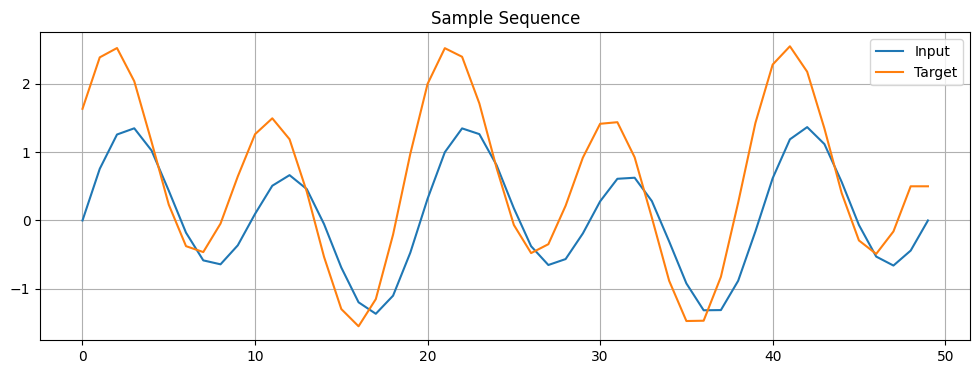

In [5]:
# Generate training data

x_train, y_train = TrainingVisualizer.generate_synthetic_data(

    num_samples=NUM_SAMPLES,
    seq_length=SEQ_LENGTH,
    input_dim=INPUT_SIZE,
    device=device

)



# Create dataloader

train_dataset = torch.utils.data.TensorDataset(x_train, y_train)

train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True
)



# Plot sample sequence

plt.figure(figsize=(12, 4))
plt.plot(x_train[0, :, 0].cpu().numpy(), label='Input')
plt.plot(y_train[0, :, 0].cpu().numpy(), label='Target')
plt.title('Sample Sequence')
plt.legend()
plt.grid(True)
plt.show()

## 3. Create and Initialize Model

In [6]:
# Initialize model

model = TransformerLNN(
    input_size=INPUT_SIZE,
    hidden_size=HIDDEN_SIZE,
    num_heads=NUM_HEADS

).to(device)

# Loss and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

# Initialize visualizer

visualizer = TrainingVisualizer()

## 4. Training Loop with Visualization

Epoch 50/50, Average Loss: 0.0001


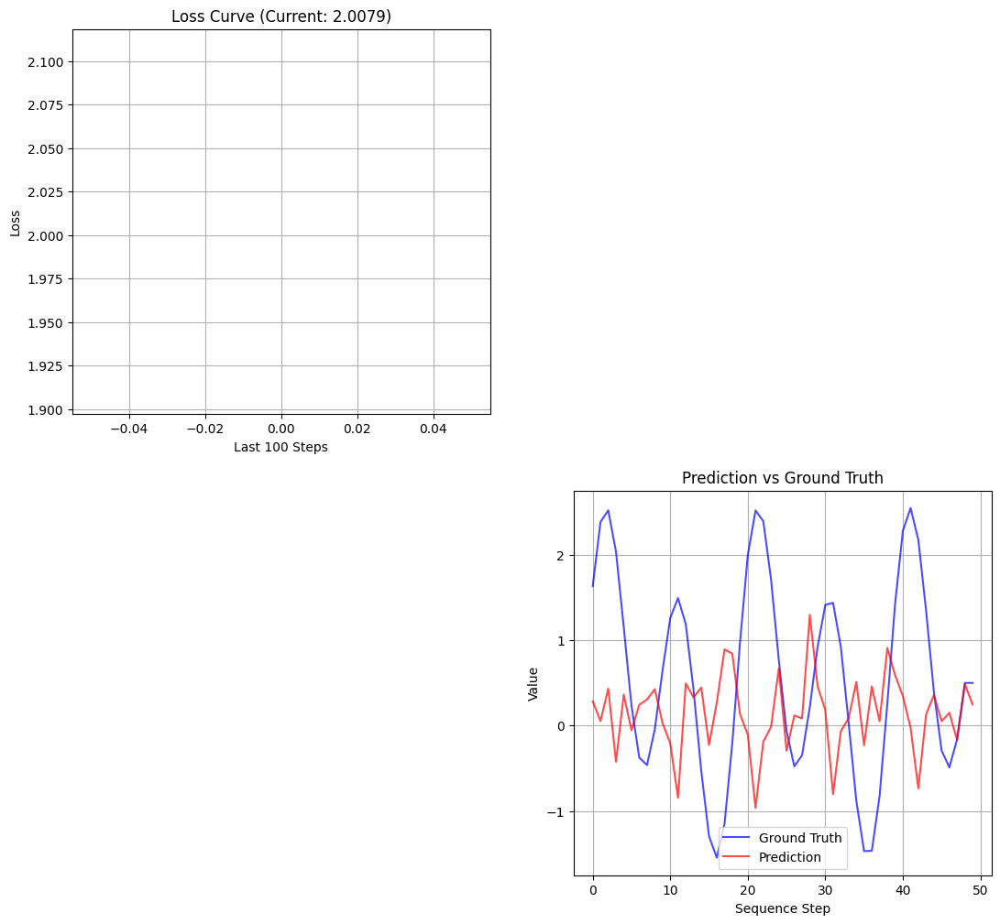

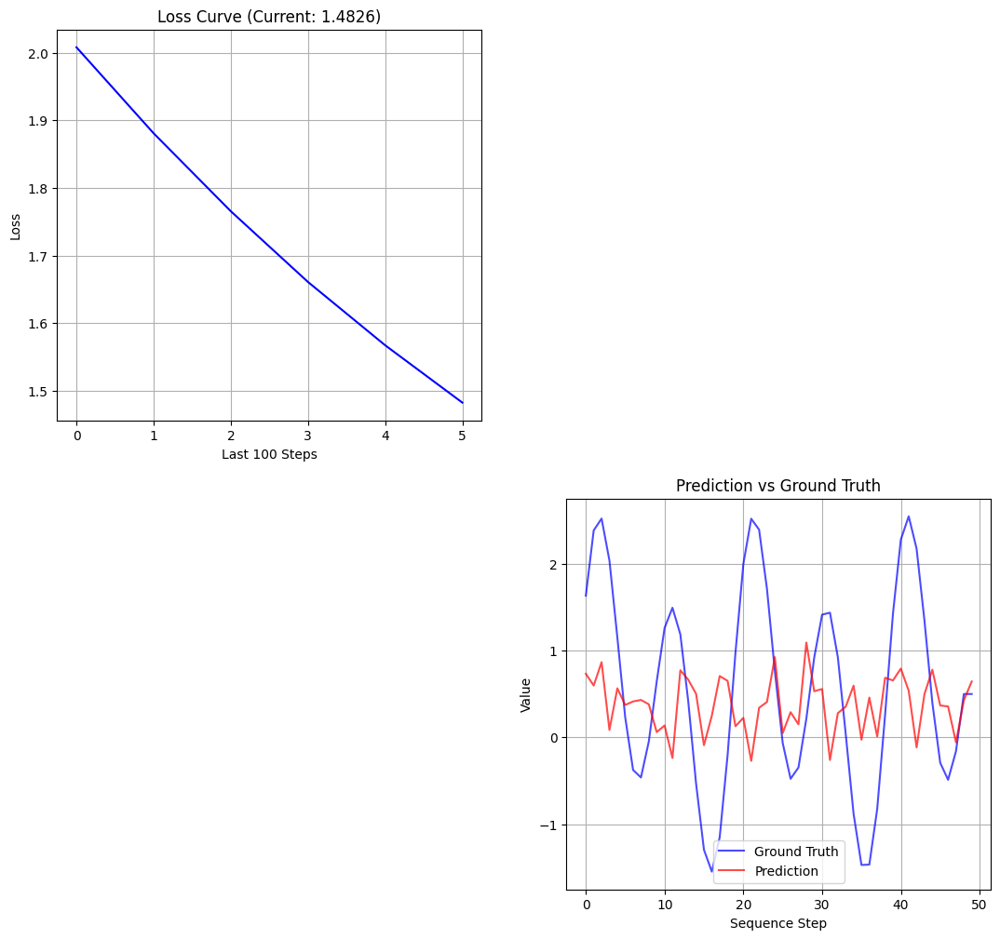

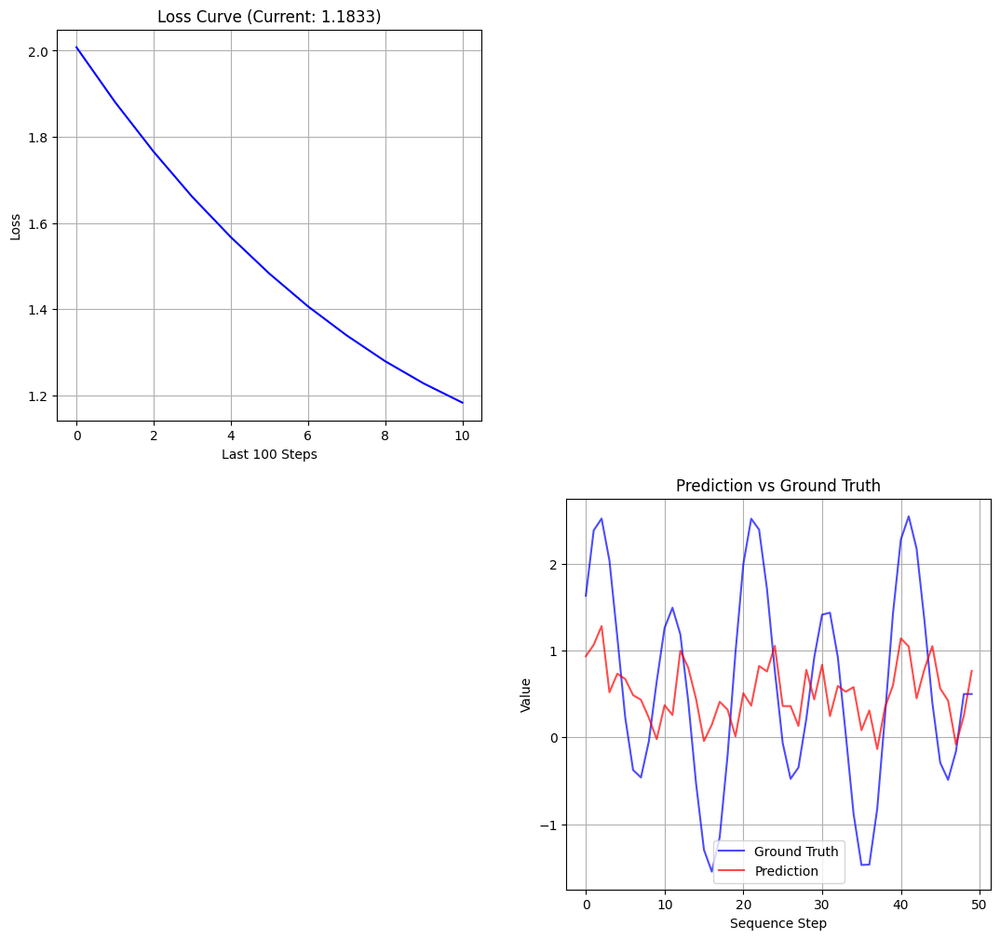

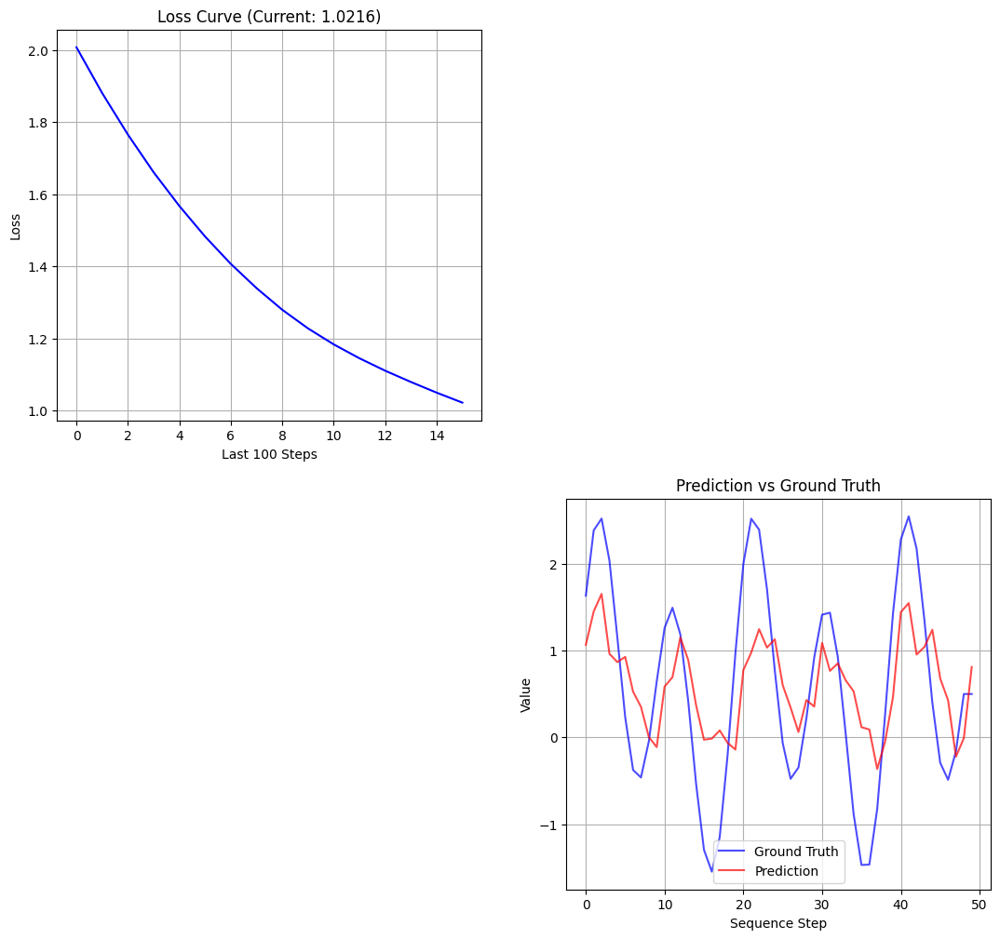

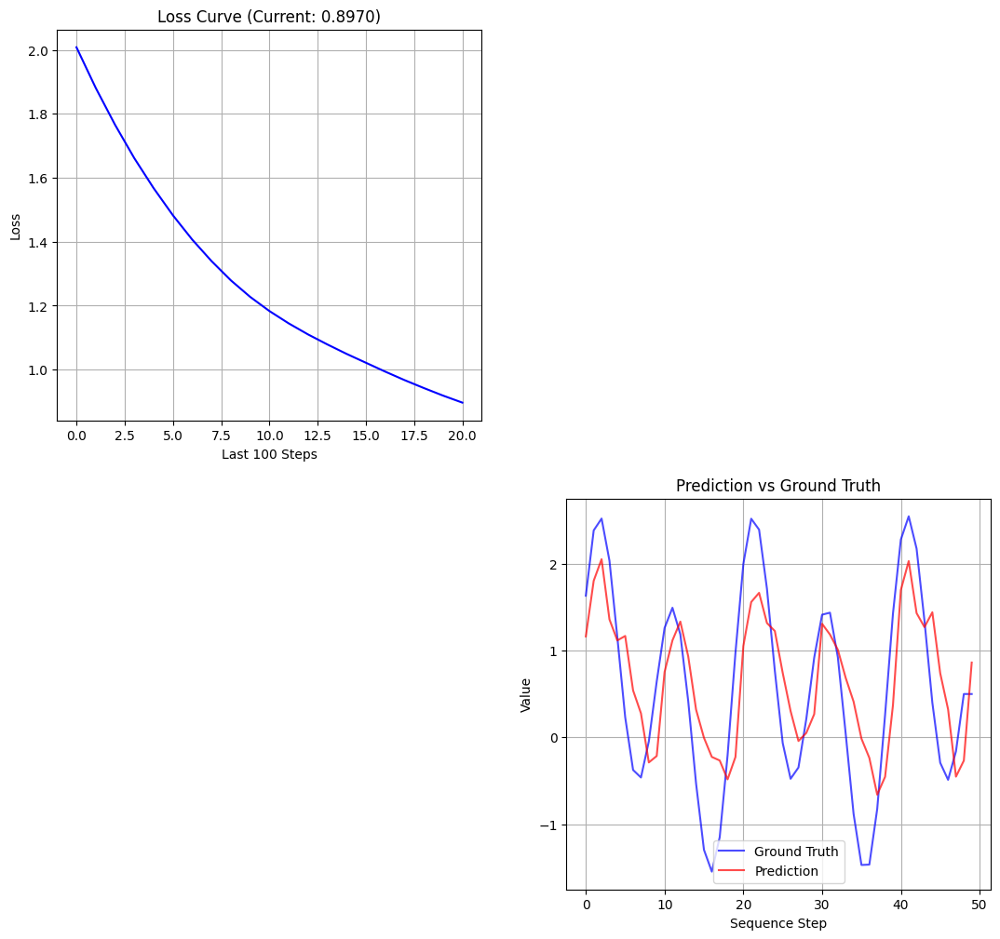

...

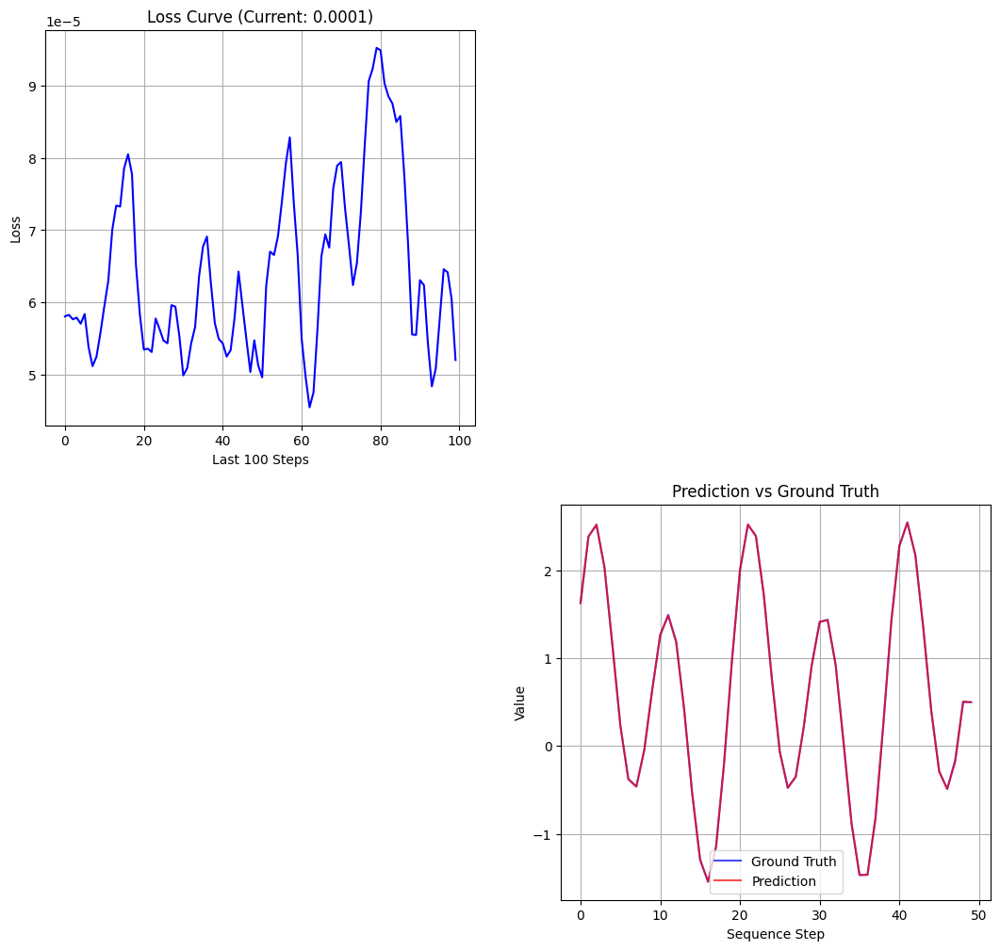

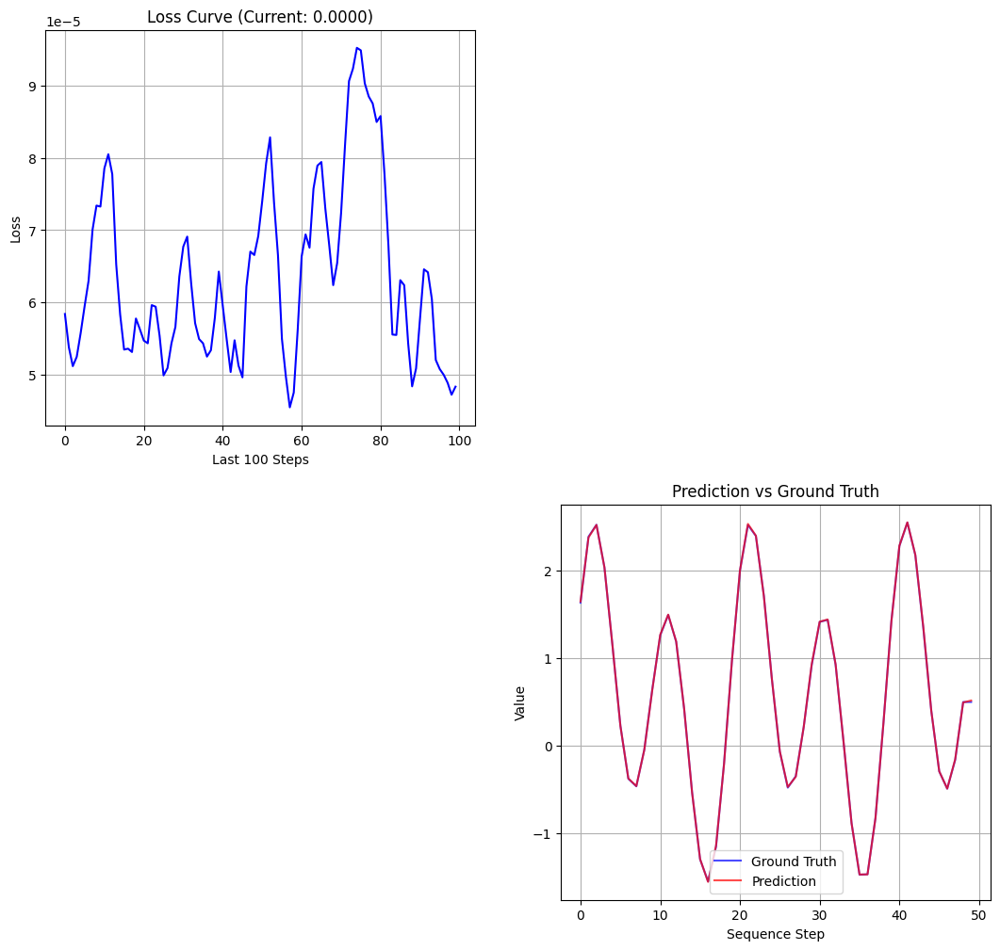

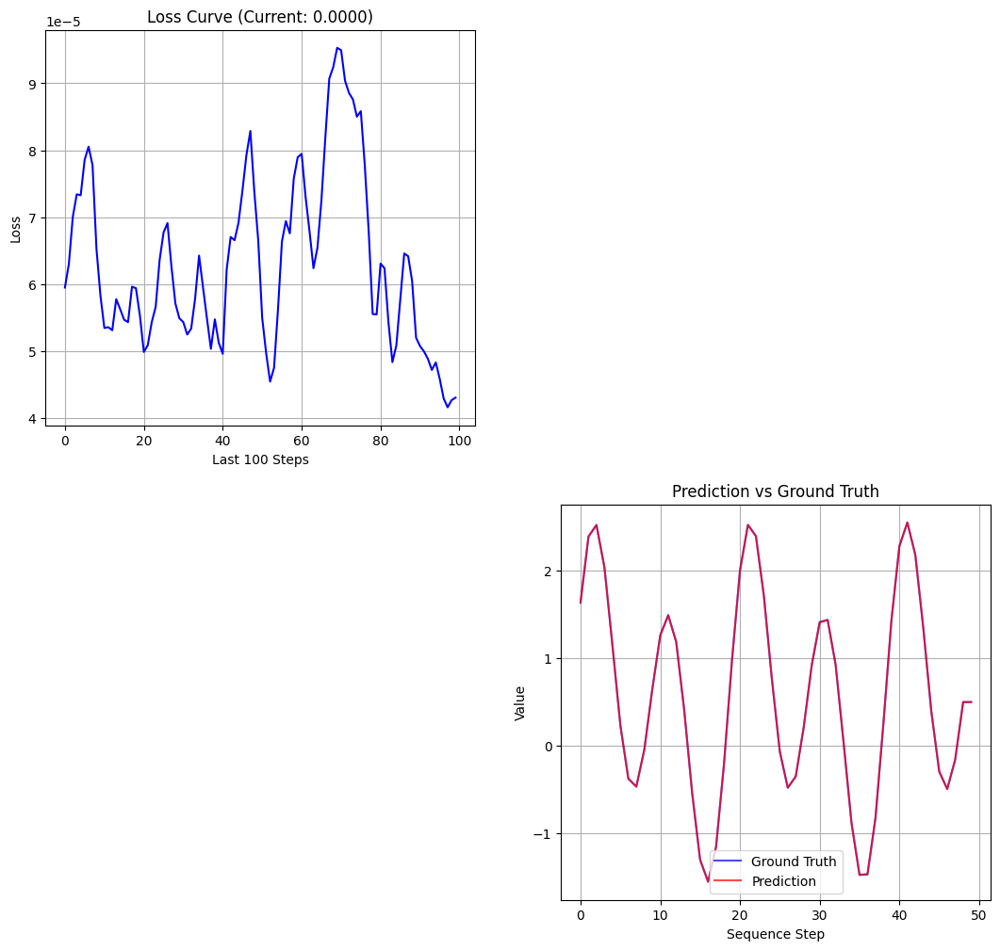

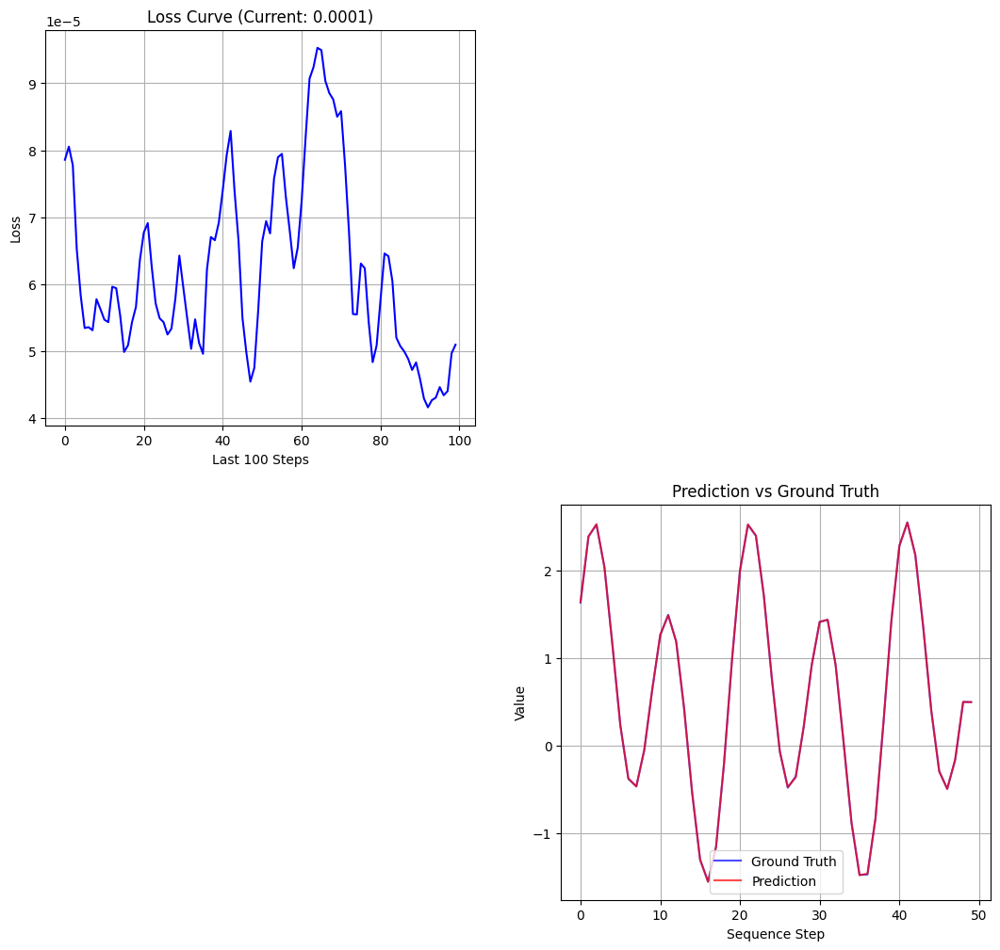

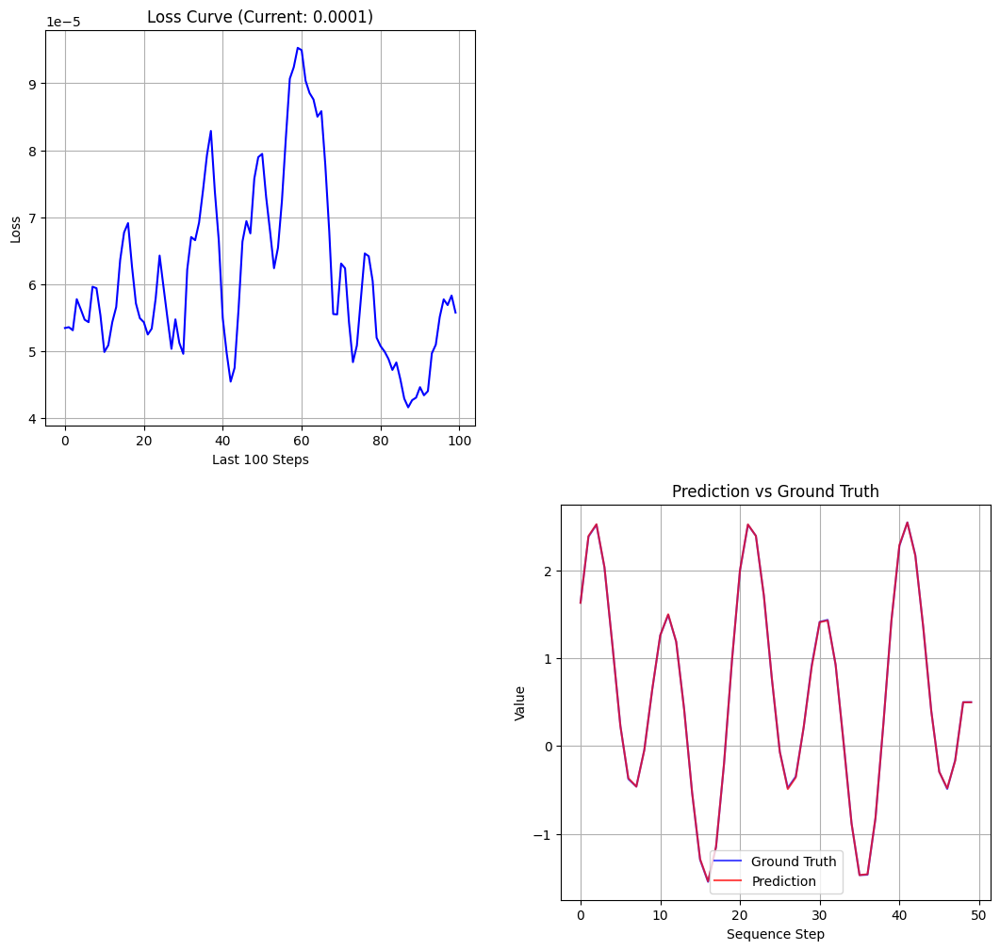

In [7]:
for epoch in range(NUM_EPOCHS):
    model.train()
    epoch_loss = 0

    

    for batch_idx, (x, y) in enumerate(train_loader):
        
        # Forward pass
        y_pred = model(x)
        loss = criterion(y_pred, y)
    
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

        # Update visualization
        if batch_idx % visualizer.save_intervals == 0:
            
            with torch.no_grad():
                
                # Get model states
                batch_input = x[0:1]  # Shape: [1, seq_len, input_dim]
                projected = model.input_proj(batch_input)  # Shape: [1, seq_len, hidden_size]

                # Take first timestep for LTC state
                ltc_input = projected[:, 0, :]  # Shape: [1, hidden_size]
                ltc_state, _ = model.ltc(
                    ltc_input,
                    torch.zeros(1, HIDDEN_SIZE, device=device),
                    torch.zeros(1, device=device)
                )

        attn_weights = model.get_attention_weights(batch_input)


        # Compute accuracy

        mse = ((y_pred - y) ** 2).mean().item()

        accuracy = 100 * (1 - min(mse, 1))

        

        # Update visualizer

        visualizer.update_metrics(loss.item(), accuracy, ltc_state, attn_weights)

        

        # Plot progress

        if batch_idx % visualizer.plot_intervals == 0:

            visualizer.plot_training_progress(epoch, batch_idx, x, y, y_pred)

    

    # End of epoch summary

    avg_loss = epoch_loss / len(train_loader)

    print(f"Epoch {epoch+1}/{NUM_EPOCHS}, Average Loss: {avg_loss:.4f}")

## 5. Final Evaluation

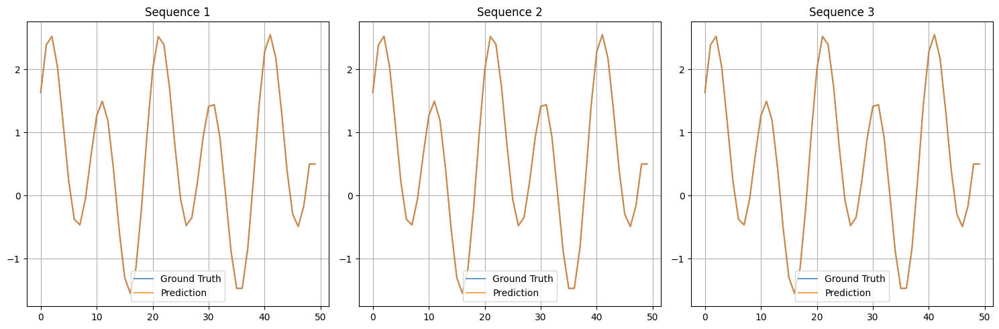

Final Test Loss: 0.0000


In [8]:
# Generate test data

x_test, y_test = TrainingVisualizer.generate_synthetic_data(

    num_samples=10,

    seq_length=SEQ_LENGTH,

    input_dim=INPUT_SIZE,

    device=device

)



# Model evaluation

model.eval()

with torch.no_grad():

    y_pred = model(x_test)

    test_loss = criterion(y_pred, y_test)

    

    # Plot predictions

    plt.figure(figsize=(15, 5))

    for i in range(3):  # Plot first 3 sequences

        plt.subplot(1, 3, i+1)

        plt.plot(y_test[i, :, 0].cpu().numpy(), label='Ground Truth', alpha=0.7)

        plt.plot(y_pred[i, :, 0].cpu().numpy(), label='Prediction', alpha=0.7)

        plt.title(f'Sequence {i+1}')

        plt.legend()

        plt.grid(True)

    plt.tight_layout()

    plt.show()

    

print(f"Final Test Loss: {test_loss:.4f}")

## 6. Analyze Learning Progression

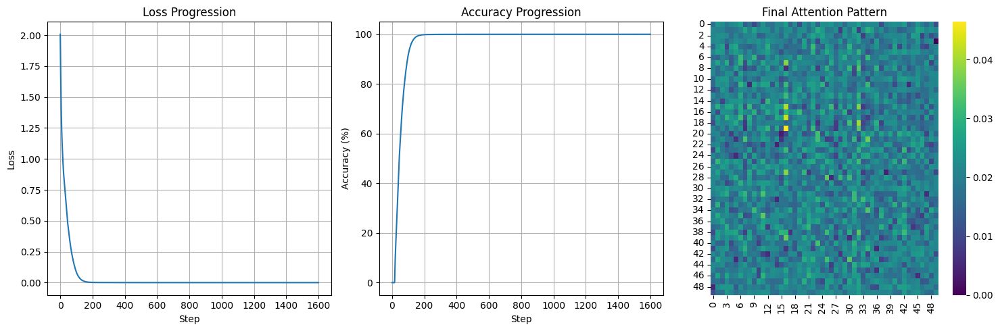

In [9]:
# Plot training history

plt.figure(figsize=(15, 5))



# Loss progression

plt.subplot(131)

plt.plot(visualizer.losses, label='Training Loss')

plt.title('Loss Progression')

plt.xlabel('Step')

plt.ylabel('Loss')

plt.grid(True)



# Accuracy progression

plt.subplot(132)

plt.plot(visualizer.accuracies, label='Accuracy')

plt.title('Accuracy Progression')

plt.xlabel('Step')

plt.ylabel('Accuracy (%)')

plt.grid(True)



# Final attention pattern

plt.subplot(133)

# Extract a 2D slice from the 3D tensor

attn_weights_2d = visualizer.attn_weights[-1][0].cpu().numpy()



# Plot the 2D attention weights

sns.heatmap(attn_weights_2d, cmap='viridis')

plt.title('Final Attention Pattern')



plt.tight_layout()

plt.show()